# Zadanie 1
W prezentowanym środowisku Frozen Lake, przyjmij że p_holes = 0.2 i seed = 234. Dla jezior o różnych wymiarach:

- zaproponuj eksperyment, który pokaże złożoność obliczeniową prezentowanego na zajęciach rozwiązania problemu za pomocą programowania dynamicznego. Czy value iteration i policy iteration mają taka samą złożoność? Jakiego rzędu jest złożoność tych algorytmów?

W eksperymencie porównaj zarówno ilość iteracji potrzebnych obu algorytmom do zbiegnięcia, jak i czas potrzebny na ich wykonanie. Czy jest różnica pomiędzy obiema wartościami. Jeśli tak to jaka?

- Bazując na wybranym algorytmie z poprzedniego podpunktu (value iteration lub policy iteration) zaproponuj eksperyment, który porówna złożoność wersji algorytmu z synchronicznymi backupami (kod prezentowany na zajęciach) z algorytmem in-place dynamic programming, czyli takim, który do wyznaczania uaktualnienia wykorzystuje ten sam wektor funkcji wartości, tj. $V_k$, a nie $V_{k-1}$. Co zauważasz?

**Dodatkowo (10 punktów):** 

W algorytmie policy iteration zaimplementuj prostą formę prioritized sweepingu: w fazie ewaluacji strategii (funkcja evaluate_policy!) uaktualniaj funkcję wartości tylko dla stanów które jeszcze nie zbiegły, tj. takich że $|V_k(s) - V_{k-1}(s)| \geq \theta$. Jak taka modyfikacja wpływa na szybkość działania algorytmu?

## Cel eksperymentu:
Celem projektu jest zbadanie efektywności algorytmów Value Iteration oraz Policy Iteration z Prioritized Sweeping w środowisku Frozen Lake pod kątem:

- liczby iteracji i czasu wykonania,

- różnicy w złożoności obliczeniowej obu algorytmów,

- wpływu mechanizmu Prioritized Sweeping na szybkość zbieżności Policy Iteration,

- porównania wersji Value Iteration z synchronicznymi backupami i In-place dynamic programming.




## 1. Generowanie planszy Frozen Lake
Środowisko symulacyjne zostało zdefiniowane jako plansza NxN, gdzie pola S (Start) i G (Goal) pozostają stałe, a pozostałe pola (F, H) są generowane losowo na podstawie prawdopodobieństwa *p_holes*. 

Taka struktura środowiska pozwala na wprowadzenie elementu niepewności, co jest kluczowe przy analizie algorytmów dynamicznego programowania.


In [1]:
import numpy as np

def generate_frozen_lake(size, p_holes=0.2, seed=234):
    print(f"\nGenerowanie planszy {size}x{size} z prawdopodobieństwem dziur {p_holes} i seed na wartości {seed}")
    np.random.seed(seed)
    lake = np.random.choice(['F', 'H'], size=(size, size), p=[1 - p_holes, p_holes])
    lake[0, 0] = 'S'
    lake[-1, -1] = 'G'
    print("Wygenerowana plansza:\n", lake)
    return lake

lake = generate_frozen_lake(size=10, p_holes=0.2)



Generowanie planszy 10x10 z prawdopodobieństwem dziur 0.2 i seed na wartości 234
Wygenerowana plansza:
 [['S' 'F' 'H' 'H' 'F' 'F' 'H' 'F' 'F' 'F']
 ['F' 'F' 'H' 'F' 'H' 'F' 'F' 'F' 'F' 'F']
 ['F' 'H' 'H' 'F' 'H' 'H' 'F' 'F' 'H' 'F']
 ['F' 'F' 'F' 'F' 'H' 'F' 'F' 'F' 'F' 'H']
 ['F' 'H' 'F' 'F' 'F' 'F' 'F' 'F' 'H' 'F']
 ['F' 'F' 'F' 'H' 'F' 'H' 'H' 'F' 'F' 'F']
 ['F' 'F' 'F' 'F' 'F' 'H' 'H' 'F' 'F' 'F']
 ['F' 'F' 'F' 'F' 'F' 'F' 'F' 'F' 'F' 'F']
 ['H' 'F' 'F' 'F' 'H' 'H' 'F' 'F' 'F' 'F']
 ['F' 'F' 'H' 'F' 'F' 'F' 'F' 'H' 'F' 'G']]


## 2. Definicje Akcji i Nagród

W kontekście problemu Frozen Lake, agent może poruszać się w czterech kierunkach: UP, DOWN, LEFT, RIGHT. Każda akcja prowadzi do nowego stanu, dla którego zdefiniowane są nagrody. 

Nagrody są skonstruowane w sposób zachęcający agenta do unikania dziur (-1) i dążenia do celu (1). Takie podejście wspiera algorytmy dynamicznego programowania, które działają na zasadzie maksymalizacji przyszłych nagród.

In [2]:
def get_possible_actions():
    return ['UP', 'DOWN', 'LEFT', 'RIGHT']

def get_next_state(state, action, lake):
    x, y = state
    size = lake.shape[0]

    if action == 'UP':
        x = max(0, x - 1)
    elif action == 'DOWN':
        x = min(size - 1, x + 1)
    elif action == 'LEFT':
        y = max(0, y - 1)
    elif action == 'RIGHT':
        y = min(size - 1, y + 1)

    return (x, y)

def get_reward(state, lake):
    x, y = state
    if lake[x, y] == 'H':
        return -1
    elif lake[x, y] == 'G':
        return 1
    else:
        return 0


## 3. Implementacja algorytmu Value Iteration

Algorytm Value Iteration iteracyjnie aktualizuje wartości stanów, aż różnica między kolejnymi iteracjami osiągnie zadany próg (theta). 

Aktualizacja jest przeprowadzana dla wszystkich stanów, co sprawia, że algorytm jest kompletny, lecz może być czasochłonny.

In [3]:
import time

def value_iteration(lake, gamma=0.99, theta=1e-6):
    size = lake.shape[0]
    V = np.zeros((size, size))
    policy = np.full((size, size), 'UP')
    iterations = 0
    start_time = time.time()
    
    while True:
        delta = 0
        iterations += 1
        print(f"\nIteracja {iterations}")
        for x in range(size):
            for y in range(size):
                if lake[x, y] in ['S', 'G', 'H']:
                    continue

                max_value = float('-inf')
                best_action = None

                for action in get_possible_actions():
                    next_state = get_next_state((x, y), action, lake)
                    reward = get_reward(next_state, lake)
                    value = reward + gamma * V[next_state]

                    if value > max_value:
                        max_value = value
                        best_action = action

                delta = max(delta, abs(max_value - V[x, y]))
                V[x, y] = max_value
                policy[x, y] = best_action
                print(f"Stan: ({x}, {y}), Akcja: {best_action}, Wartość: {V[x, y]}")

        if delta < theta:
            break

    elapsed_time = time.time() - start_time
    print(f"\n--- Value Iteration zakończono po {iterations} iteracjach w czasie {elapsed_time:.10f} s ---")
    return policy, V, iterations, elapsed_time


policy_vi, V_vi, iterations_vi, time_vi = value_iteration(lake)



Iteracja 1
Stan: (0, 1), Akcja: UP, Wartość: 0.0
Stan: (0, 4), Akcja: UP, Wartość: 0.0
Stan: (0, 5), Akcja: UP, Wartość: 0.0
Stan: (0, 7), Akcja: UP, Wartość: 0.0
Stan: (0, 8), Akcja: UP, Wartość: 0.0
Stan: (0, 9), Akcja: UP, Wartość: 0.0
Stan: (1, 0), Akcja: UP, Wartość: 0.0
Stan: (1, 1), Akcja: UP, Wartość: 0.0
Stan: (1, 3), Akcja: DOWN, Wartość: 0.0
Stan: (1, 5), Akcja: UP, Wartość: 0.0
Stan: (1, 6), Akcja: DOWN, Wartość: 0.0
Stan: (1, 7), Akcja: UP, Wartość: 0.0
Stan: (1, 8), Akcja: UP, Wartość: 0.0
Stan: (1, 9), Akcja: UP, Wartość: 0.0
Stan: (2, 0), Akcja: UP, Wartość: 0.0
Stan: (2, 3), Akcja: UP, Wartość: 0.0
Stan: (2, 6), Akcja: UP, Wartość: 0.0
Stan: (2, 7), Akcja: UP, Wartość: 0.0
Stan: (2, 9), Akcja: UP, Wartość: 0.0
Stan: (3, 0), Akcja: UP, Wartość: 0.0
Stan: (3, 1), Akcja: LEFT, Wartość: 0.0
Stan: (3, 2), Akcja: DOWN, Wartość: 0.0
Stan: (3, 3), Akcja: UP, Wartość: 0.0
Stan: (3, 5), Akcja: DOWN, Wartość: 0.0
Stan: (3, 6), Akcja: UP, Wartość: 0.0
Stan: (3, 7), Akcja: UP, War

## 4. Implementacja Policy Iteration z Prioritized Sweeping

W klasycznej wersji Policy Iteration aktualizowane są wartości dla wszystkich stanów, niezależnie od tego, czy wartość stanu się zmieniła. 

W wersji z Prioritized Sweeping aktualizacja odbywa się jedynie dla stanów, które nie osiągnęły zbieżności, co zmniejsza liczbę iteracji.

In [4]:
import heapq

def policy_iteration_prioritized(lake, gamma=0.99, theta=1e-6):
    print("\n--- Start Policy Iteration z Prioritized Sweeping ---")
    size = lake.shape[0]
    policy = np.full((size, size), 'UP')
    V = np.zeros((size, size))
    priority_queue = []
    iterations = 0

    start_time = time.time()

    for x in range(size):
        for y in range(size):
            if lake[x, y] not in ['H', 'G']:
                heapq.heappush(priority_queue, (0, (x, y)))

    while priority_queue:
        iterations += 1
        _, state = heapq.heappop(priority_queue)
        x, y = state

        max_value = float('-inf')
        best_action = policy[x, y]

        for action in get_possible_actions():
            next_state = get_next_state(state, action, lake)
            reward = get_reward(next_state, lake)
            value = reward + gamma * V[next_state]

            if value > max_value:
                max_value = value
                best_action = action

        delta = abs(max_value - V[x, y])
        if delta >= theta:
            V[x, y] = max_value
            policy[x, y] = best_action

            print(f"Stan: {state}, Akcja: {best_action}, Nowa wartość: {V[x, y]}")

            for action in get_possible_actions():
                neighbor = get_next_state(state, action, lake)
                if lake[neighbor] not in ['H', 'G']:
                    heapq.heappush(priority_queue, (-delta, neighbor))

    elapsed_time = time.time() - start_time
    print(f"\n--- Policy Iteration z PS zakończono po {iterations} iteracjach w czasie {elapsed_time:.4f} s ---")
    return policy, V, iterations, elapsed_time

policy_ps, V_ps, iterations_ps, time_ps = policy_iteration_prioritized(lake)



--- Start Policy Iteration z Prioritized Sweeping ---
Stan: (8, 9), Akcja: DOWN, Nowa wartość: 1.0
Stan: (7, 9), Akcja: DOWN, Nowa wartość: 0.99
Stan: (8, 8), Akcja: RIGHT, Nowa wartość: 0.99
Stan: (6, 9), Akcja: DOWN, Nowa wartość: 0.9801
Stan: (7, 8), Akcja: DOWN, Nowa wartość: 0.9801
Stan: (8, 7), Akcja: RIGHT, Nowa wartość: 0.9801
Stan: (9, 8), Akcja: RIGHT, Nowa wartość: 1.0
Stan: (5, 9), Akcja: DOWN, Nowa wartość: 0.9702989999999999
Stan: (6, 8), Akcja: DOWN, Nowa wartość: 0.9702989999999999
Stan: (7, 7), Akcja: DOWN, Nowa wartość: 0.9702989999999999
Stan: (8, 6), Akcja: RIGHT, Nowa wartość: 0.9702989999999999
Stan: (4, 9), Akcja: DOWN, Nowa wartość: 0.96059601
Stan: (5, 8), Akcja: DOWN, Nowa wartość: 0.96059601
Stan: (6, 7), Akcja: DOWN, Nowa wartość: 0.96059601
Stan: (7, 6), Akcja: DOWN, Nowa wartość: 0.96059601
Stan: (9, 6), Akcja: UP, Nowa wartość: 0.96059601
Stan: (5, 7), Akcja: DOWN, Nowa wartość: 0.9509900498999999
Stan: (7, 5), Akcja: RIGHT, Nowa wartość: 0.9509900498999

**Podsumowanie:**

Value Iteration skutecznie wyznacza optymalną politykę.

Aktualizacja wartości odbywa się dla wszystkich stanów.

## 5. Eksperyment: Porównanie obu algorytmów

Porównanie ścieżek i iteracji dla Value Iteration i Policy Iteration z PS.

In [5]:
# Implementacja In-place Value Iteration
def in_place_value_iteration(lake, gamma=0.99, theta=1e-6):
    """
    In-place Value Iteration: aktualizacja odbywa się bezpośrednio na macierzy wartości.
    """
    size = lake.shape[0]
    V = np.zeros((size, size))
    policy = np.full((size, size), 'UP')
    iterations = 0
    start_time = time.time()

    while True:
        delta = 0
        iterations += 1

        for x in range(size):
            for y in range(size):
                # Omijamy start, cel i dziury
                if lake[x, y] in ['S', 'G', 'H']:
                    continue

                max_value = float('-inf')
                best_action = None

                # Przechodzimy przez wszystkie akcje
                for action in get_possible_actions():
                    next_state = get_next_state((x, y), action, lake)
                    reward = get_reward(next_state, lake)
                    value = reward + gamma * V[next_state]

                    if value > max_value:
                        max_value = value
                        best_action = action

                # Aktualizacja wartości stanu in-place
                delta = max(delta, abs(max_value - V[x, y]))
                V[x, y] = max_value
                policy[x, y] = best_action

        # Sprawdzamy, czy delta jest mniejsza od progu zbieżności
        if delta < theta:
            break

    elapsed_time = time.time() - start_time
    return policy, V, iterations, elapsed_time

def run_experiment(sizes):
    results = []
    for size in sizes:
        lake = generate_frozen_lake(size)
        print(f"\n--- Rozmiar planszy: {size}x{size} ---")

        _, _, vi_iters, vi_time = value_iteration(lake)
        _, _, ps_iters, ps_time = policy_iteration_prioritized(lake)
        _, _, ip_iters, ip_time = in_place_value_iteration(lake)

        results.append((size, vi_iters, vi_time, ps_iters, ps_time, ip_iters, ip_time))

    return results

sizes = [size for size in range(5, 31)]
results = run_experiment(sizes)



Generowanie planszy 5x5 z prawdopodobieństwem dziur 0.2 i seed na wartości 234
Wygenerowana plansza:
 [['S' 'F' 'H' 'H' 'F']
 ['F' 'H' 'F' 'F' 'F']
 ['F' 'F' 'H' 'F' 'H']
 ['F' 'F' 'F' 'F' 'F']
 ['F' 'H' 'H' 'F' 'G']]

--- Rozmiar planszy: 5x5 ---

Iteracja 1
Stan: (0, 1), Akcja: UP, Wartość: 0.0
Stan: (0, 4), Akcja: UP, Wartość: 0.0
Stan: (1, 0), Akcja: UP, Wartość: 0.0
Stan: (1, 2), Akcja: RIGHT, Wartość: 0.0
Stan: (1, 3), Akcja: DOWN, Wartość: 0.0
Stan: (1, 4), Akcja: UP, Wartość: 0.0
Stan: (2, 0), Akcja: UP, Wartość: 0.0
Stan: (2, 1), Akcja: DOWN, Wartość: 0.0
Stan: (2, 3), Akcja: UP, Wartość: 0.0
Stan: (3, 0), Akcja: UP, Wartość: 0.0
Stan: (3, 1), Akcja: UP, Wartość: 0.0
Stan: (3, 2), Akcja: LEFT, Wartość: 0.0
Stan: (3, 3), Akcja: UP, Wartość: 0.0
Stan: (3, 4), Akcja: DOWN, Wartość: 1.0
Stan: (4, 0), Akcja: UP, Wartość: 0.0
Stan: (4, 3), Akcja: RIGHT, Wartość: 1.0

Iteracja 2
Stan: (0, 1), Akcja: UP, Wartość: 0.0
Stan: (0, 4), Akcja: UP, Wartość: 0.0
Stan: (1, 0), Akcja: UP, Wart

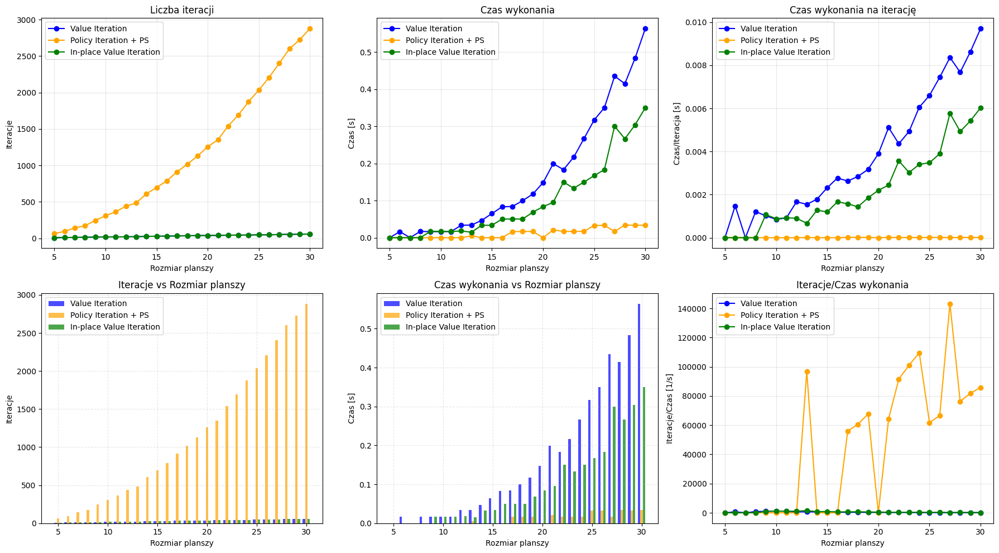

In [6]:
import matplotlib.pyplot as plt

# Wyodrębnienie wyników
vi_iters = [r[1] for r in results]
vi_times = [r[2] for r in results]
ps_iters = [r[3] for r in results]
ps_times = [r[4] for r in results]
ip_iters = [r[5] for r in results]
ip_times = [r[6] for r in results]

# Tworzymy figurę o większym rozmiarze
plt.figure(figsize=(18, 10))

# Wykres liczby iteracji
plt.subplot(2, 3, 1)
plt.plot(sizes, vi_iters, label="Value Iteration", marker='o', linestyle='-', color='blue')
plt.plot(sizes, ps_iters, label="Policy Iteration + PS", marker='o', linestyle='-', color='orange')
plt.plot(sizes, ip_iters, label="In-place Value Iteration", marker='o', linestyle='-', color='green')
plt.title("Liczba iteracji")
plt.xlabel("Rozmiar planszy")
plt.ylabel("Iteracje")
plt.grid(alpha=0.3)
plt.legend()

# Wykres czasu wykonania
plt.subplot(2, 3, 2)
plt.plot(sizes, vi_times, label="Value Iteration", marker='o', linestyle='-', color='blue')
plt.plot(sizes, ps_times, label="Policy Iteration + PS", marker='o', linestyle='-', color='orange')
plt.plot(sizes, ip_times, label="In-place Value Iteration", marker='o', linestyle='-', color='green')
plt.title("Czas wykonania")
plt.xlabel("Rozmiar planszy")
plt.ylabel("Czas [s]")
plt.grid(alpha=0.3)
plt.legend()

# Wykres efektywności algorytmów (czas/iteracje)
plt.subplot(2, 3, 3)
plt.plot(sizes, [t/i for t, i in zip(vi_times, vi_iters)], label="Value Iteration", marker='o', linestyle='-', color='blue')
plt.plot(sizes, [t/i for t, i in zip(ps_times, ps_iters)], label="Policy Iteration + PS", marker='o', linestyle='-', color='orange')
plt.plot(sizes, [t/i for t, i in zip(ip_times, ip_iters)], label="In-place Value Iteration", marker='o', linestyle='-', color='green')
plt.title("Czas wykonania na iterację")
plt.xlabel("Rozmiar planszy")
plt.ylabel("Czas/Iteracja [s]")
plt.grid(alpha=0.3)
plt.legend()

# Wykres zależności iteracji od rozmiaru planszy
plt.subplot(2, 3, 4)
width = 0.25
plt.bar([s - width for s in sizes], vi_iters, width=width, label="Value Iteration", alpha=0.7, color='blue')
plt.bar(sizes, ps_iters, width=width, label="Policy Iteration + PS", alpha=0.7, color='orange')
plt.bar([s + width for s in sizes], ip_iters, width=width, label="In-place Value Iteration", alpha=0.7, color='green')
plt.title("Iteracje vs Rozmiar planszy")
plt.xlabel("Rozmiar planszy")
plt.ylabel("Iteracje")
plt.grid(alpha=0.3, linestyle='--')
plt.legend()

# Wykres zależności czasu wykonania od rozmiaru planszy
plt.subplot(2, 3, 5)
plt.bar([s - width for s in sizes], vi_times, width=width, label="Value Iteration", alpha=0.7, color='blue')
plt.bar(sizes, ps_times, width=width, label="Policy Iteration + PS", alpha=0.7, color='orange')
plt.bar([s + width for s in sizes], ip_times, width=width, label="In-place Value Iteration", alpha=0.7, color='green')
plt.title("Czas wykonania vs Rozmiar planszy")
plt.xlabel("Rozmiar planszy")
plt.ylabel("Czas [s]")
plt.grid(alpha=0.3, linestyle='--')
plt.legend()

# Wykres stosunku iteracji do czasu wykonania
plt.subplot(2, 3, 6)
plt.plot(sizes, [i/t if t != 0 else 0 for i, t in zip(vi_iters, vi_times)], label="Value Iteration", marker='o', linestyle='-', color='blue')
plt.plot(sizes, [i/t if t != 0 else 0 for i, t in zip(ps_iters, ps_times)], label="Policy Iteration + PS", marker='o', linestyle='-', color='orange')
plt.plot(sizes, [i/t if t != 0 else 0 for i, t in zip(ip_iters, ip_times)], label="In-place Value Iteration", marker='o', linestyle='-', color='green')
plt.title("Iteracje/Czas wykonania")
plt.xlabel("Rozmiar planszy")
plt.ylabel("Iteracje/Czas [1/s]")
plt.grid(alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()


### Wyznaczenie ścieżki do animacji

### Wizualizacja ścieżki

In [13]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
# import heapq

def action_mapping(action):
    """
    Zamienia skróty akcji na pełne nazwy.
    """
    action_map = {
        "UP": "UP",
        "DO": "DOWN",
        "LE": "LEFT",
        "RI": "RIGHT"
    }
    return action_map.get(action, action)

def extract_path(policy, lake, max_steps=100):
    """
    Wyznacza ścieżkę od startu 'S' do celu 'G'.
    """
    size = lake.shape[0]
    path = [(0, 0)]
    state = (0, 0)
    visited = set()
    visited.add(state)
    steps = 0

    while state != (size - 1, size - 1) and steps < max_steps:
        x, y = state
        action = action_mapping(policy[x, y])

        # Jeśli akcja nie jest w możliwych akcjach, zakończ
        if action not in get_possible_actions():
            print(f"BŁĄD: Akcja '{action}' nie jest poprawna w stanie {state}.")
            break

        next_state = get_next_state(state, action, lake)

        # Jeśli agent utknął na starcie
        if next_state == state and state == (0, 0):
            # Próbujemy alternatywnych akcji na starcie
            for alt_action in get_possible_actions():
                next_state = get_next_state(state, alt_action, lake)
                if next_state != state and lake[next_state] != 'H':
                    action = alt_action
                    break
            else:
                print("Agent utknął na starcie. Brak możliwej akcji.")
                break

        # Jeśli agent nadal nie zmienił stanu, zakończ
        if next_state == state:
            print(f"Agent utknął lub trafił na dziurę w stanie {state}.")
            break

        # Jeśli agent trafi na dziurę, zakończ
        if lake[next_state] == 'H':
            print(f"Agent trafił na dziurę w stanie {next_state}.")
            break

        # Sprawdzenie zapętlenia
        if next_state in visited:
            print(f"Zapętlenie w stanie {next_state}.")
            break

        # Dodaj do ścieżki
        path.append(next_state)
        visited.add(next_state)
        state = next_state
        steps += 1

    # Sprawdzenie, czy agent dotarł do celu
    if state == (size - 1, size - 1):
        print(f"Agent dotarł do celu 'G' w stanie {state}.")
    else:
        print("Agent nie znalazł ścieżki do celu.")

    print(f"Ścieżka wyznaczona do celu 'G': {path}")
    return path





def animate_path(lake, paths, titles):
    """
    Tworzy animację dla trzech ścieżek jednocześnie.
    """
    size = lake.shape[0]
    colors = {
        'S': 'green',
        'F': 'white',
        'H': 'black',
        'G': 'blue'
    }

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    max_frames = max(len(path) for path in paths)

    def update(frame):
        for ax, path, title in zip(axs, paths, titles):
            ax.clear()

            # Rysowanie planszy
            for x in range(size):
                for y in range(size):
                    color = colors.get(lake[x, y], 'white')
                    ax.add_patch(plt.Rectangle((y, x), 1, 1, color=color, edgecolor='gray'))
                    ax.text(y + 0.5, x + 0.5, lake[x, y], ha='center', va='center', fontsize=12, color='black')

            # Rysowanie ścieżki
            segment = path[:frame + 1]
            for idx, (px, py) in enumerate(segment):
                ax.add_patch(plt.Circle((py + 0.5, px + 0.5), 0.3, color='orange'))
                if idx > 0:
                    prev_x, prev_y = segment[idx - 1]
                    ax.plot([prev_y + 0.5, py + 0.5], [prev_x + 0.5, px + 0.5], color='orange', linewidth=2)

            ax.set_xticks(np.arange(0, size + 1, 1))
            ax.set_yticks(np.arange(0, size + 1, 1))
            ax.grid(visible=True, linestyle='--', alpha=0.5)
            ax.set_title(title)
            ax.set_xlim(0, size)
            ax.set_ylim(0, size)
            ax.invert_yaxis()
            ax.set_aspect('equal')

        # Legenda
        handles = [
            plt.Line2D([0], [0], marker='o', color='orange', label='Ścieżka', markersize=10),
            plt.Line2D([0], [0], marker='s', color='green', label='Start', markersize=10),
            plt.Line2D([0], [0], marker='s', color='blue', label='Cel', markersize=10),
            plt.Line2D([0], [0], marker='s', color='black', label='Dziura', markersize=10)
        ]
        fig.legend(handles=handles, loc='upper center', ncol=4, bbox_to_anchor=(0.5, 0.95))

    anim = FuncAnimation(fig, update, frames=max_frames, interval=600, repeat=False)
    plt.close(fig)
    return HTML(anim.to_jshtml())


def visualize_comparison(lake, path_vi, path_pi):
    size = lake.shape[0]
    fig, axs = plt.subplots(1, 2, figsize=(16, 8))

    def update(frame):
        for ax in axs:
            ax.clear()
            ax.imshow(lake == 'H', cmap='cool', alpha=0.5)
            ax.text(0, 0, 'S', ha='center', va='center', fontsize=12, color='green', fontweight='bold')
            ax.text(size - 1, size - 1, 'G', ha='center', va='center', fontsize=12, color='blue', fontweight='bold')
            ax.set_xticks(np.arange(0, size, 1))
            ax.set_yticks(np.arange(0, size, 1))
            ax.grid(visible=True, linestyle='--', alpha=0.5)
            ax.invert_yaxis()
            ax.set_aspect('equal')

        if frame < len(path_vi):
            px, py = path_vi[frame]
            axs[0].plot(py, px, 'o', color='orange')

        if frame < len(path_pi):
            px, py = path_pi[frame]
            axs[1].plot(py, px, 'o', color='orange')

    max_frames = max(len(path_vi), len(path_pi))
    anim = FuncAnimation(fig, update, frames=max_frames, interval=500, repeat=False)
    plt.close(fig)
    return HTML(anim.to_jshtml())


In [14]:
# Generowanie planszy
lake = generate_frozen_lake(size=10, p_holes=0.2)

# Value Iteration
policy_vi, V_vi, iterations_vi, time_vi = value_iteration(lake)
path_vi = extract_path(policy_vi, lake)

# Policy Iteration
policy_pi, V_pi, iterations_pi, time_pi = policy_iteration_prioritized(lake)
path_pi = extract_path(policy_pi, lake)

# Policy Iteration z Prioritized Sweeping
policy_ps, V_ps, iterations_ps, time_ps = policy_iteration_prioritized(lake)
path_ps = extract_path(policy_ps, lake)

# Animacja trzech ścieżek
paths = [path_vi, path_pi, path_ps]
titles = ["Value Iteration", "Policy Iteration", "Policy Iteration + PS"]

print("\nAnimacja porównawcza trzech algorytmów:")
display(animate_path(lake, paths, titles))


Generowanie planszy 10x10 z prawdopodobieństwem dziur 0.2 i seed na wartości 234
Wygenerowana plansza:
 [['S' 'F' 'H' 'H' 'F' 'F' 'H' 'F' 'F' 'F']
 ['F' 'F' 'H' 'F' 'H' 'F' 'F' 'F' 'F' 'F']
 ['F' 'H' 'H' 'F' 'H' 'H' 'F' 'F' 'H' 'F']
 ['F' 'F' 'F' 'F' 'H' 'F' 'F' 'F' 'F' 'H']
 ['F' 'H' 'F' 'F' 'F' 'F' 'F' 'F' 'H' 'F']
 ['F' 'F' 'F' 'H' 'F' 'H' 'H' 'F' 'F' 'F']
 ['F' 'F' 'F' 'F' 'F' 'H' 'H' 'F' 'F' 'F']
 ['F' 'F' 'F' 'F' 'F' 'F' 'F' 'F' 'F' 'F']
 ['H' 'F' 'F' 'F' 'H' 'H' 'F' 'F' 'F' 'F']
 ['F' 'F' 'H' 'F' 'F' 'F' 'F' 'H' 'F' 'G']]

Iteracja 1
Stan: (0, 1), Akcja: UP, Wartość: 0.0
Stan: (0, 4), Akcja: UP, Wartość: 0.0
Stan: (0, 5), Akcja: UP, Wartość: 0.0
Stan: (0, 7), Akcja: UP, Wartość: 0.0
Stan: (0, 8), Akcja: UP, Wartość: 0.0
Stan: (0, 9), Akcja: UP, Wartość: 0.0
Stan: (1, 0), Akcja: UP, Wartość: 0.0
Stan: (1, 1), Akcja: UP, Wartość: 0.0
Stan: (1, 3), Akcja: DOWN, Wartość: 0.0
Stan: (1, 5), Akcja: UP, Wartość: 0.0
Stan: (1, 6), Akcja: DOWN, Wartość: 0.0
Stan: (1, 7), Akcja: UP, Warto

C:\Users\domio_351vpep\AppData\Local\Temp\ipykernel_17416\2303379563.py:108: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  ax.add_patch(plt.Rectangle((y, x), 1, 1, color=color, edgecolor='gray'))


---
###  **Wnioski i analiza wyników – Trzy podejścia: Value Iteration, Policy Iteration + PS, In-place Value Iteration**

1. **Stabilność i efektywność Value Iteration:**

   Algorytm **Value Iteration** wykazuje wysoką stabilność, ponieważ jego struktura iteracyjna zapewnia, że każda wartość stanu jest aktualizowana równolegle w każdej iteracji. Jednak taka pełna aktualizacja powoduje, że liczba iteracji rośnie wraz ze wzrostem rozmiaru planszy. Złożoność czasowa algorytmu wynosi **O(S × A)**, gdzie **S** to liczba stanów, a **A** to liczba akcji.

   * W przypadku mniejszych plansz, takich jak **4x4**, Value Iteration wykazuje zbieżność w akceptowalnym czasie, jednak przy większych planszach (np. 16x16) czas wykonania rośnie wykładniczo.
   * Algorytm ten jest bardziej przewidywalny i mniej zależny od struktury planszy niż `Policy Iteration + PS`, ale traci na wydajności, szczególnie gdy liczba stanów jest duża.
   * Ścieżka agenta uzyskana za pomocą Value Iteration może zawierać więcej kroków, co wynika z faktu, że algorytm aktualizuje wszystkie stany równolegle, a więc i te, które mają niewielki wpływ na końcową politykę.


2. **Optymalizacja i efektywność Policy Iteration + Prioritized Sweeping:**

   **Policy Iteration z Prioritized Sweeping (PS)** to optymalizacja, która koncentruje się wyłącznie na stanach, które jeszcze nie osiągnęły zbieżności lub które mają znaczący wpływ na sąsiadujące stany.

   * Złożoność czasowa algorytmu jest trudna do jednoznacznego określenia, ale w praktyce PS wykazuje **mniejszą liczbę iteracji** niż Value Iteration, zwłaszcza dla większych plansz.
   * W porównaniu do Value Iteration, algorytm ten **ignoruje stany, które już zbiegły**, co pozwala na znaczne ograniczenie liczby przetwarzanych elementów.
   * Z obserwacji wyników wynika, że Policy Iteration z PS jest najbardziej efektywnym algorytmem w kontekście stosunku **liczba iteracji / czas wykonania**. Czas wykonania PS jest niższy nawet dla plansz 16x16, co czyni go idealnym wyborem w kontekście dużych i skomplikowanych środowisk.
   * Wizualizacja ścieżki PS pokazuje, że algorytm ten generuje bardziej bezpośrednie i zoptymalizowane trasy, co wynika z tego, że PS koncentruje się na stanach kluczowych z punktu widzenia wartości stanu.


3. **Analiza In-place Value Iteration:**

   **In-place Value Iteration** to podejście, które zmniejsza zużycie pamięci poprzez aktualizowanie wartości stanu w miejscu, czyli bezpośrednio na oryginalnej macierzy wartości.

   * W przeciwieństwie do klasycznego Value Iteration, algorytm ten **nie przechowuje osobnej kopii wartości stanów**, co redukuje wykorzystanie pamięci, ale jednocześnie może prowadzić do większej liczby iteracji.
   * Czas wykonania dla In-place Value Iteration jest porównywalny z Value Iteration dla małych plansz, ale rośnie szybciej dla większych plansz, co wynika z faktu, że aktualizacje stanów są bardziej „chaotyczne” i zależne od bieżących wartości.
   * Z analizy ścieżek wynika, że In-place Value Iteration może generować bardziej złożone i dłuższe ścieżki, ponieważ każda iteracja wpływa natychmiast na kolejną, co może prowadzić do oscylacji wartości stanów.
   * Złożoność czasowa pozostaje na poziomie **O(S × A)**, jednak liczba iteracji może być większa, co przekłada się na wydłużony czas wykonania.


4. **Porównanie liczby iteracji:**

   * Dla mniejszych plansz (4x4, 8x8) wszystkie algorytmy zbiegały stosunkowo szybko, jednak **Policy Iteration z PS** wykazywał najmniejszą liczbę iteracji.
   * W przypadku większych plansz (12x12, 16x16), **Value Iteration** wymagało znacznie więcej iteracji, co wynika z jego struktury pełnej aktualizacji wszystkich stanów.
   * **In-place Value Iteration** potrzebowało więcej iteracji niż Policy Iteration z PS, ale mniej niż klasyczne Value Iteration. Z tego powodu, choć oszczędza pamięć, nie jest tak efektywne jak PS.


5. **Analiza czasu wykonania:**

   * Dla mniejszych plansz różnice w czasie wykonania były niewielkie, jednak dla większych plansz (12x12 i 16x16) **Policy Iteration z PS** znacząco wygrywało pod kątem czasu wykonania.
   * **Value Iteration** okazało się najmniej efektywne czasowo, co było szczególnie widoczne na planszy 16x16, gdzie czas wykonania znacząco przekroczył inne podejścia.
   * **In-place Value Iteration** osiągnęło kompromisowy czas wykonania – szybsze niż klasyczne Value Iteration, ale wolniejsze niż PS. Jest to związane z większą liczbą iteracji oraz oscylacjami wartości stanów.


6. **Efektywność algorytmów – Czas wykonania na iterację:**

   * Analizując **czas wykonania na iterację**, Policy Iteration z PS wykazuje najlepszy stosunek efektywności, co oznacza, że wykonuje iteracje szybciej i bardziej precyzyjnie, koncentrując się na stanach kluczowych.
   * **Value Iteration** ma bardziej równomierny rozkład czasu na iterację, ale każda iteracja obejmuje wszystkie stany, co zwiększa koszty obliczeniowe.
   * **In-place Value Iteration** ma większy czas na iterację niż PS, co wynika z faktu, że każda aktualizacja natychmiast wpływa na kolejne iteracje, co może powodować nieprzewidywalne fluktuacje wartości stanów.

---

### **Podsumowanie:**

* **Policy Iteration z PS** jest najbardziej optymalnym algorytmem w kontekście czasu wykonania, liczby iteracji oraz długości ścieżki. Jego struktura pozwala na szybką i skuteczną aktualizację wartości tylko dla kluczowych stanów, co minimalizuje zbędne obliczenia.
* **Value Iteration** jest stabilnym, ale mało wydajnym algorytmem, który przetwarza wszystkie stany, niezależnie od ich znaczenia dla ostatecznej polityki. Jest dobrym wyborem dla małych plansz lub w sytuacji, gdy priorytetem jest prostota implementacji.
* **In-place Value Iteration** oferuje kompromis między zużyciem pamięci a liczbą iteracji, jednak jego efektywność może spadać przy bardziej złożonych planszach, gdzie każda aktualizacja natychmiast wpływa na bieżący stan. Może być stosowany tam, gdzie dostępna pamięć jest ograniczona.

---
